**Dog vs Cat Classification**

Classifying images as Cat or Dog Using Transfer Learning.

In [6]:
# configuring the path of Kaggle.json file
!mkdir p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘p’: File exists
mkdir: cannot create directory ‘/root/.kaggle’: File exists


 It creates a hidden directory named .kaggle, copies the kaggle.json file (containing API credentials) into this directory, and sets appropriate permissions to ensure the file is not readable by others. This allows the notebook to interact with Kaggle datasets and competitions using the provided API key.

In [7]:
# Kaggle api
!kaggle competitions download -c dogs-vs-cats

 98% 792M/812M [00:08<00:00, 247MB/s]
100% 812M/812M [00:08<00:00, 97.7MB/s]


In [8]:
!ls

dogs-vs-cats.zip  kaggle.json  p  sample_data


In [9]:
# extracting the zip file

from zipfile import ZipFile
dataset='/content/dogs-vs-cats.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [10]:
# extracting the zip file

from zipfile import ZipFile
dataset='/content/train.zip'

with ZipFile(dataset,'r') as zip:
  zip.extractall()
  print('The dataset is extracted')

The dataset is extracted


In [11]:
import os
path,dirs,files=next(os.walk('/content/train'))
file_count=len(files)
print(f'{file_count} files were found')

25000 files were found


The code snippet imports the os module to interact with the operating system. It then uses the os.walk() function to traverse the directory '/content/train', extracting the path, directories, and files within it. The number of files is counted and printed to the console. This code provides a simple way to determine the number of files present in a specific directory.

Printing name of images

In [12]:
file_name=os.listdir('/content/train')
print(file_name)

['dog.564.jpg', 'cat.8231.jpg', 'dog.7980.jpg', 'cat.11050.jpg', 'cat.11608.jpg', 'dog.7739.jpg', 'cat.10799.jpg', 'dog.11516.jpg', 'cat.3091.jpg', 'cat.8363.jpg', 'dog.11381.jpg', 'dog.3889.jpg', 'cat.1916.jpg', 'cat.9332.jpg', 'dog.964.jpg', 'dog.7899.jpg', 'dog.8346.jpg', 'cat.4330.jpg', 'cat.1171.jpg', 'cat.4250.jpg', 'cat.5525.jpg', 'dog.11784.jpg', 'dog.10019.jpg', 'dog.261.jpg', 'cat.5003.jpg', 'cat.1683.jpg', 'cat.5922.jpg', 'dog.10515.jpg', 'dog.7527.jpg', 'cat.5621.jpg', 'cat.10600.jpg', 'cat.11803.jpg', 'cat.11152.jpg', 'dog.1432.jpg', 'dog.12127.jpg', 'cat.5603.jpg', 'dog.5324.jpg', 'dog.8450.jpg', 'cat.4045.jpg', 'dog.6527.jpg', 'cat.8693.jpg', 'cat.3548.jpg', 'dog.8202.jpg', 'cat.8040.jpg', 'dog.11223.jpg', 'cat.9435.jpg', 'dog.11225.jpg', 'dog.1778.jpg', 'dog.267.jpg', 'dog.620.jpg', 'cat.6179.jpg', 'dog.10665.jpg', 'cat.5374.jpg', 'dog.2228.jpg', 'cat.11899.jpg', 'dog.7396.jpg', 'dog.1742.jpg', 'cat.1015.jpg', 'cat.7633.jpg', 'dog.9880.jpg', 'cat.8582.jpg', 'cat.80.jpg'

importing the libraries

In [13]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.model_selection import train_test_split
from google.colab.patches import cv2_imshow

Displaying dogs and cats

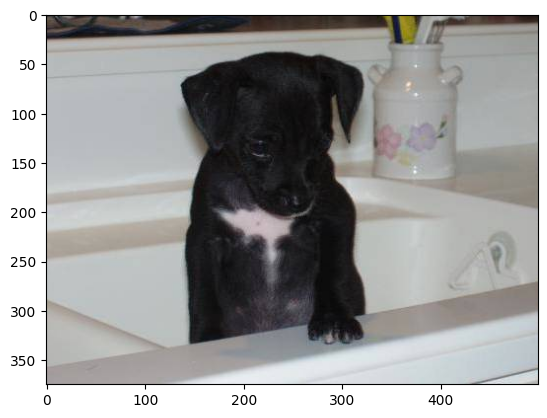

In [14]:
# display dog image
img=mpimg.imread('/content/train/dog.8298.jpg')
imgplot=plt.imshow(img)
plt.show()

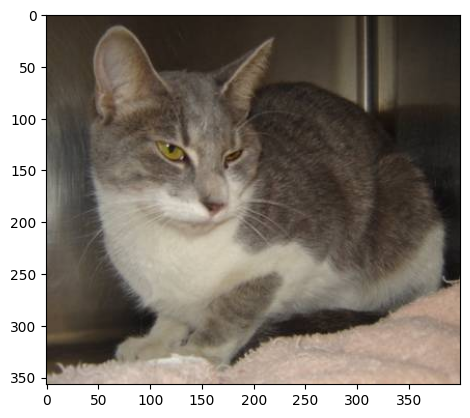

In [15]:
# display cat image
img=mpimg.imread('/content/train/cat.4352.jpg')
imgplot=plt.imshow(img)
plt.show()

In [16]:
file_name=os.listdir('/content/train/')

for i in range(5):
  name=file_name[i]
  print(name[0:3])

dog
cat
dog
cat
cat


In [17]:
file_names=os.listdir('/content/train/')

dog_count=0
cat_count=0

for img_file in file_names:

  name= img_file[0:3]
  if name=='dog':
    dog_count+=1
  elif name=='cat':
    cat_count+=1

print('Number of dogs:',dog_count)
print('Number of cats:',cat_count)

Number of dogs: 12500
Number of cats: 12500


In [18]:
# creating a directory for resized miages

os.mkdir('/content/image resized')

In [19]:
original_folder='/content/train/'
resized_folder='/content/image resized/'

for i in range(2000):
  filename=os.listdir(original_folder)[i]
  img_path=original_folder+filename

  img=Image.open(img_path)
  img=img.resize((224,224))
  img=img.convert('RGB')
  newImgPath=resized_folder+filename
  img.save(newImgPath)

This code resizes and saves images from one folder to another. It first defines the paths of the original image folder (original_folder) and the destination folder for resized images (resized_folder). Using a for loop, it iterates through the first 2000 images in original_folder. For each image, it constructs the path, opens the image, resizes it to 224x224 pixels, and converts it to RGB format to ensure consistent color channels. The resized image is then saved to resized_folder with the same filename. This script is useful for preparing images in a standardized format, often necessary in machine learning tasks for model consistency.

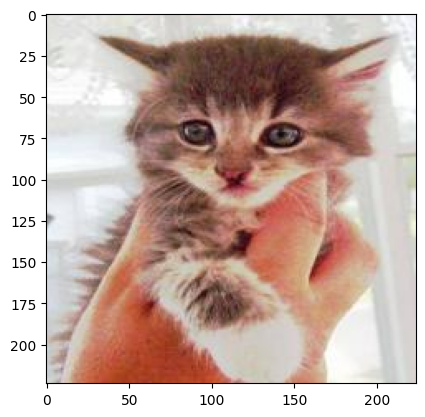

In [21]:
# display  resized image

img=mpimg.imread('/content/image resized/cat.100.jpg')
imgplot=plt.imshow(img)
plt.show()

Creating labels

Cat --> 0

Dog --> 1

In [22]:
# assign labels
filenames=os.listdir('/content/image resized/')

labels =[]

for i in range(2000):
  file_name=filenames[i]
  label = file_name[0:3]
  if label=='cat':
    labels.append(0)
  elif label=='dog':
    labels.append(1)

In [23]:
print(filenames[0:5])
print(len(filenames))

['dog.564.jpg', 'cat.8231.jpg', 'dog.7980.jpg', 'cat.11050.jpg', 'cat.11608.jpg']
2000


In [24]:
print(labels[0:5])
print(len(labels))

[1, 0, 1, 0, 0]
2000


In [25]:
values,counts=np.unique(labels,return_counts=True)
print(values)
print(counts)

[0 1]
[1016  984]


Converting resized images to numpy arrays

In [26]:
import cv2
import glob

In [27]:
image_directory='/content/image resized/'
image_extension=['jpg','png']

files=[]

[files.extend(glob.glob(image_directory+'*.'+e)) for e in image_extension]
dog_cat_images=np.asarray([cv2.imread(file) for file in files])

This code loads images with specific file extensions from a designated directory into a NumPy array. The image_directory variable specifies the folder containing the images, and image_extension lists the allowed file types (e.g., 'jpg' and 'png'). An empty list files is created to store the paths of these images. A list comprehension with glob.glob searches for files matching each extension in the directory, adding them to files. Finally, the code reads each image file path in files using cv2.imread() and converts the list of images into a NumPy array (dog_cat_images). This array can then be used for processing, analysis, or as input for machine learning models.

In [28]:
print(dog_cat_images)

[[[[170 171 167]
   [125 128 126]
   [ 72  77  76]
   ...
   [101  97 108]
   [183 179 190]
   [167 163 174]]

  [[191 192 188]
   [158 161 159]
   [ 66  70  71]
   ...
   [135 131 142]
   [216 212 223]
   [205 201 212]]

  [[199 200 198]
   [174 177 175]
   [105 109 110]
   ...
   [191 188 197]
   [243 240 249]
   [229 226 235]]

  ...

  [[ 64  47  60]
   [ 62  45  58]
   [ 59  42  55]
   ...
   [ 40  34  59]
   [ 41  34  61]
   [ 44  37  64]]

  [[ 60  43  56]
   [ 57  40  53]
   [ 54  37  50]
   ...
   [ 36  30  55]
   [ 37  32  59]
   [ 41  36  63]]

  [[ 54  37  50]
   [ 52  35  48]
   [ 51  34  47]
   ...
   [ 35  29  54]
   [ 36  31  58]
   [ 41  36  63]]]


 [[[ 30  68  86]
   [ 34  72  90]
   [ 39  76  96]
   ...
   [168 143 117]
   [165 140 114]
   [163 138 112]]

  [[ 10  47  69]
   [ 13  50  72]
   [ 18  55  77]
   ...
   [167 143 119]
   [163 139 117]
   [162 138 114]]

  [[  8  42  71]
   [ 11  45  74]
   [ 14  48  77]
   ...
   [157 137 119]
   [154 134 117]
   [153 133

In [29]:
type(dog_cat_images)

numpy.ndarray

In [30]:
print(dog_cat_images.shape)

(2000, 224, 224, 3)


**Building the model**

In [31]:
x=dog_cat_images
y=np.asarray(labels)

In [32]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=2)

In [33]:
print(x.shape)
print(x_train.shape)
print(x_test.shape)

(2000, 224, 224, 3)
(1600, 224, 224, 3)
(400, 224, 224, 3)


In [34]:
# scaling the data
x_train_scaled=x_train/255
x_test_scaled=x_test/255

In [35]:
print(x_train_scaled)

[[[[0.78431373 0.77647059 0.8       ]
   [0.79607843 0.78823529 0.81176471]
   [0.80392157 0.79607843 0.81960784]
   ...
   [0.69411765 0.69019608 0.70588235]
   [0.68627451 0.68235294 0.69803922]
   [0.68627451 0.68235294 0.69803922]]

  [[0.80392157 0.79607843 0.81960784]
   [0.80392157 0.79607843 0.81960784]
   [0.8        0.79215686 0.81568627]
   ...
   [0.69411765 0.69019608 0.70588235]
   [0.69019608 0.68627451 0.70196078]
   [0.68627451 0.68235294 0.69803922]]

  [[0.8        0.79215686 0.81568627]
   [0.79607843 0.78823529 0.81176471]
   [0.78823529 0.78039216 0.80392157]
   ...
   [0.69803922 0.69411765 0.70980392]
   [0.69411765 0.69019608 0.70588235]
   [0.69019608 0.68627451 0.70196078]]

  ...

  [[0.66666667 0.66666667 0.71372549]
   [0.66666667 0.66666667 0.71372549]
   [0.67058824 0.67058824 0.71764706]
   ...
   [0.72156863 0.70196078 0.69019608]
   [0.71764706 0.69803922 0.68627451]
   [0.70980392 0.69019608 0.67843137]]

  [[0.67058824 0.67058824 0.71764706]
   [0.6

Building the neural network

In [36]:
import tensorflow as tf
import tensorflow_hub as hub
# Check Keras version and import tf_keras if needed
if tf.keras.__version__.startswith("3."):
    import tf_keras as keras  # Use tf_keras instead of tf.keras
else:
    keras = tf.keras  # Continue using tf.keras

num_of_classes = 2
mobilenet_model = 'https://tfhub.dev/google/tf2-preview/mobilenet_v2/feature_vector/4'
pretrained_model = hub.KerasLayer(mobilenet_model, input_shape=(224, 224, 3), trainable=False)

# Use keras.Sequential instead of tf.keras.Sequential
model = keras.Sequential([
    pretrained_model,
    keras.layers.Dense(num_of_classes)  # Use keras.layers instead of tf.keras.layers
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1280)              2257984   
                                                                 
 dense (Dense)               (None, 2)                 2562      
                                                                 
Total params: 2260546 (8.62 MB)
Trainable params: 2562 (10.01 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


This code builds a TensorFlow model using a pre-trained MobileNetV2 feature extractor from TensorFlow Hub. It first checks the Keras version; if it's version 3 or higher, it imports tf_keras as keras, otherwise it uses tf.keras directly. The model is designed for a classification task with num_of_classes set to 2 (e.g., binary classification). The pre-trained MobileNetV2 model is loaded from TensorFlow Hub as a non-trainable feature extractor with an input shape of (224, 224, 3). A dense layer with two units is added to classify the extracted features. Finally, model.summary() displays the architecture and parameter details of the model.

In [37]:
model.compile(
    optimizer = 'adam',
    loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    metrics = ['acc']
)

In [38]:
model.fit(x_train_scaled, y_train, epochs=5)

Epoch 1/5
50/50 [==============================] - 76s 1s/step - loss: 0.1746 - acc: 0.9331
Epoch 2/5
50/50 [==============================] - 71s 1s/step - loss: 0.0671 - acc: 0.9775
Epoch 3/5
50/50 [==============================] - 70s 1s/step - loss: 0.0500 - acc: 0.9850
Epoch 4/5
50/50 [==============================] - 67s 1s/step - loss: 0.0387 - acc: 0.9894
Epoch 5/5
50/50 [==============================] - 72s 1s/step - loss: 0.0316 - acc: 0.9931


In [39]:
score, acc = model.evaluate(x_test_scaled, y_test)
print('Test Loss =', score)
print('Test Accuracy =', acc)

13/13 [==============================] - 25s 2s/step - loss: 0.0569 - acc: 0.9775
Test Loss = 0.05691632255911827
Test Accuracy = 0.9775000214576721


Path of the image to be predicted: /content/cat.jpg


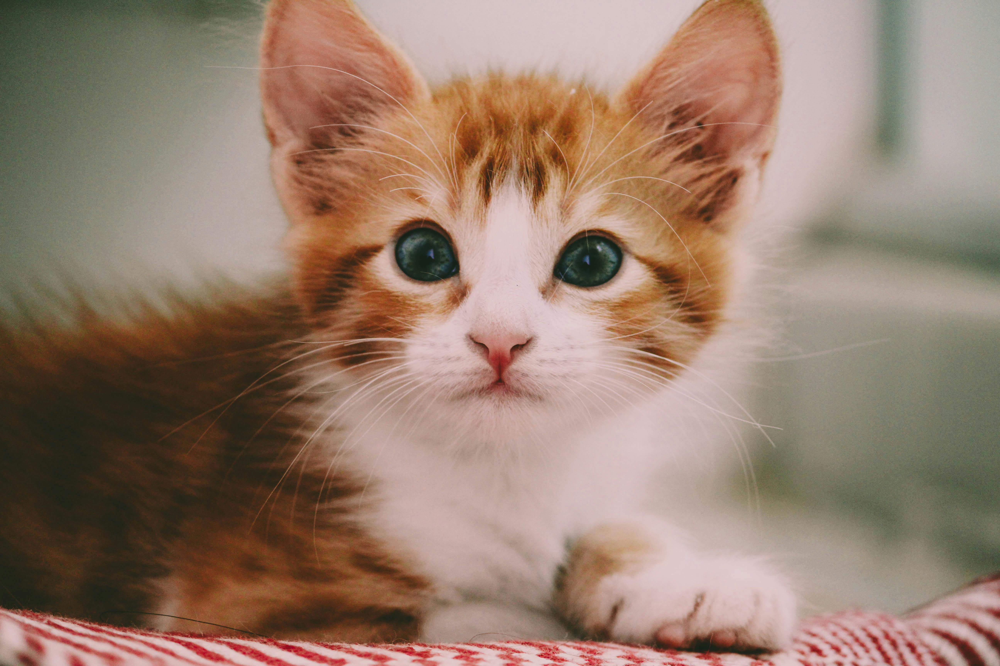

1/1 [==============================] - 1s 1s/step
[[ 4.87103   -4.5975127]]
0
The image represents a Cat


In [40]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
  print('The image represents a Dog')

This code takes an image as input, processes it, and uses a trained model to predict whether the image represents a cat or a dog. It begins by prompting the user for the file path of the image to be predicted. The image is then read and displayed using cv2_imshow. Next, the image is resized to 224x224 pixels to match the model’s input shape, and the pixel values are scaled to a range of 0-1 by dividing by 255. The scaled image is reshaped to include a batch dimension, making it a 4D tensor of shape (1, 224, 224, 3). This processed image is fed into the model for prediction, and the result is stored in input_prediction. The label with the highest probability is identified using np.argmax, and based on this label, the code prints either "The image represents a Cat" or "The image represents a Dog."

Path of the image to be predicted: /content/dog.jpg


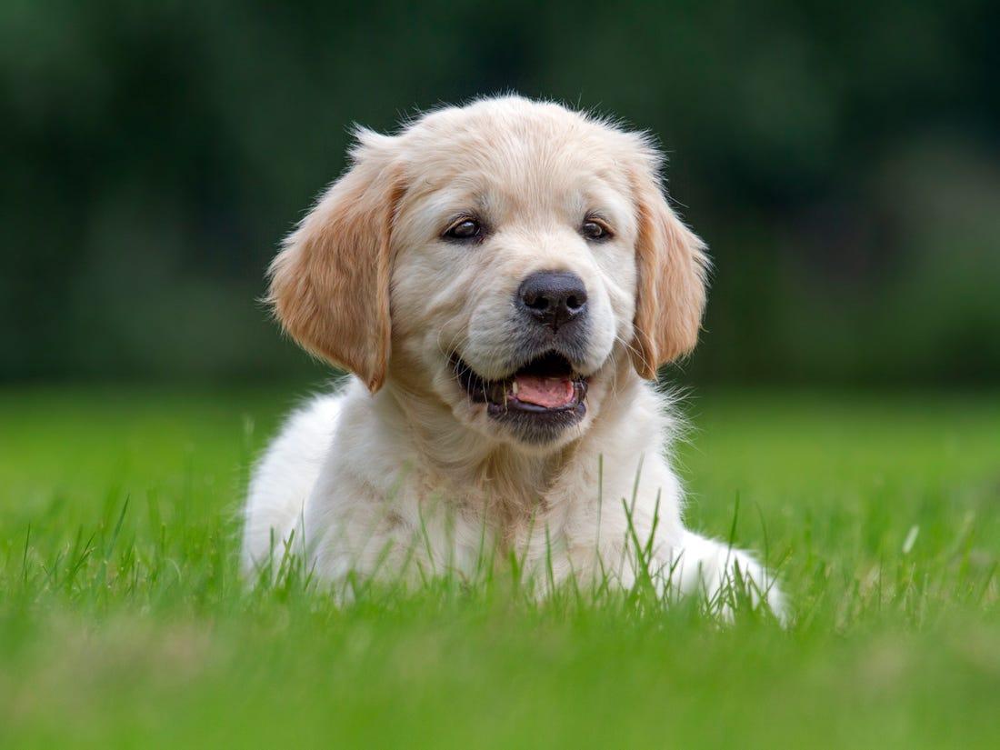

1/1 [==============================] - 0s 77ms/step
[[-4.618787   3.8246684]]
1
The image represents a Dog


In [41]:
input_image_path = input('Path of the image to be predicted: ')

input_image = cv2.imread(input_image_path)

cv2_imshow(input_image)

input_image_resize = cv2.resize(input_image, (224,224))

input_image_scaled = input_image_resize/255

image_reshaped = np.reshape(input_image_scaled, [1,224,224,3])

input_prediction = model.predict(image_reshaped)

print(input_prediction)

input_pred_label = np.argmax(input_prediction)

print(input_pred_label)

if input_pred_label == 0:
  print('The image represents a Cat')

else:
   print('The image represents a Dog')

This code takes an image as input, processes it, and uses a trained model to predict whether the image represents a cat or a dog. It begins by prompting the user for the file path of the image to be predicted. The image is then read and displayed using cv2_imshow. Next, the image is resized to 224x224 pixels to match the model’s input shape, and the pixel values are scaled to a range of 0-1 by dividing by 255. The scaled image is reshaped to include a batch dimension, making it a 4D tensor of shape (1, 224, 224, 3). This processed image is fed into the model for prediction, and the result is stored in input_prediction. The label with the highest probability is identified using np.argmax, and based on this label, the code prints either "The image represents a Cat" or "The image represents a Dog."